In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from scipy import signal
import IPython.display as ipd
import librosa
import pandas as pd
from scipy import signal

In [2]:
def print_plot_play(x, Fs, text=''):
    """1. Prints information about an audio singal, 2. plots the waveform, and 3. Creates player

    Args:
        x: Input signal
        Fs: Sampling rate of x
        text: Text to print
    """
    print('%s Fs = %d, x.shape = %s, x.dtype = %s' % (text, Fs, x.shape, x.dtype))
    fig = plt.figure(figsize=(8, 2))
    ax = fig.add_subplot(111)
    plt.plot(x, color='gray')
    plt.xlim([0, x.shape[0]])
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()
    ipd.display(ipd.Audio(data=x, rate=Fs))

In [3]:
def print_plot_play_with_label(x, Fs, label, text=''):
    """1. Prints information about an audio singal, 2. plots the waveform, and 3. Creates player

    Args:
        x: Input signal
        Fs: Sampling rate of x
        text: Text to print
    """
    print('%s Fs = %d, x.shape = %s, x.dtype = %s' % (text, Fs, x.shape, x.dtype))
    fig = plt.figure(figsize=(8, 2))
    ax = fig.add_subplot(111)
    start_y = min(x)
    heigh_y = max(x) - min(x)
    for i in range(len(label)):
        start_x = label[i,0] * Fs
        width_x = (label[i,1] -  label[i,0]) * Fs
        rect = Rectangle((start_x,start_y),width_x,heigh_y,linewidth=1,edgecolor='r',facecolor='none')
        ax.add_patch(rect)
    plt.plot(x, color='gray')
    plt.xlim([0, x.shape[0]])
    plt.xlabel('Time (samples)')
    plt.ylabel('Amplitude')
    plt.tight_layout()
    plt.show()
    ipd.display(ipd.Audio(data=x, rate=Fs))

In [4]:
# from google.colab import drive
# drive.mount('/content/drive')

Labeled taps - knuckle: 30, pad: 30, nail_tip_tap: 30, nail_tap: 30
knuckle Fs = 48000, x.shape = (3523520,), x.dtype = float32


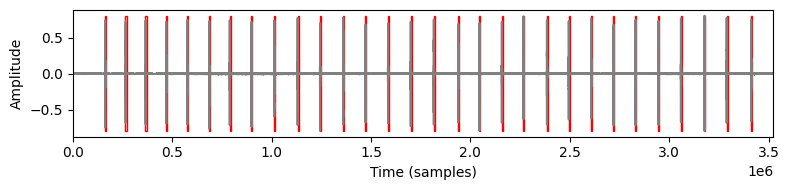

pad Fs = 48000, x.shape = (2630592,), x.dtype = float32


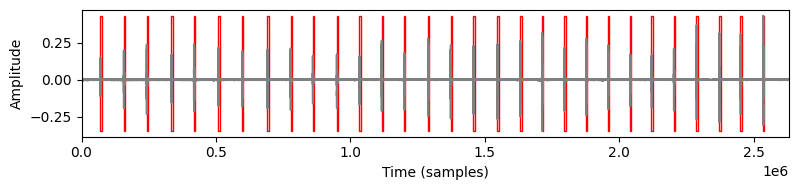

nail_tip_tap Fs = 48000, x.shape = (2442176,), x.dtype = float32


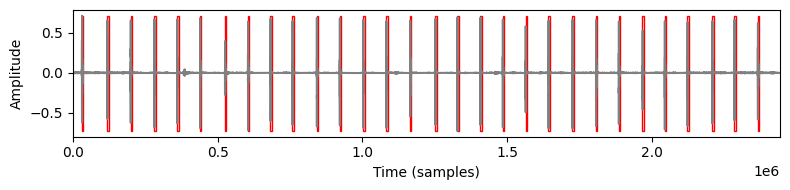

nail_tap Fs = 48000, x.shape = (2601920,), x.dtype = float32


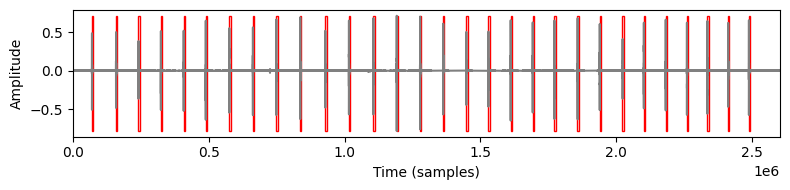

In [5]:
#Read data from audio files and label files

# # Read audio files
# knuckle_file = "./recorded_dataset-shamika/Knuckle.mp3"
# # nail_file = "./recorded_dataset-shamika/Finger nail tip tap.mp3"
# # pad_file = "./audio_file/pad.wav"
# # knuckle_file = "./audio_file/knuckle.wav"
# pad_file = "./audio_file/pad.wav"
# nail_file = "./audio_file/nail.wav"

knuckle_file = "./data/train/Knuckle.m4a"
pad_file = "./data/train/Pad.m4a"
nail_tip_tap_file = "./data/train/Nail tip tap.m4a"
nail_tap_file = "./data/train/Nail tap.m4a"

# Prefer the repo's decoder (ffmpeg/wave). Fall back to librosa if needed.
def load_audio(path):
    from scripts.auto_annotate_taps import decode_audio_mono

    try:
        x, sr = decode_audio_mono(path, target_sr=None, use_ffmpeg=True)
        return x, sr
    except Exception:
        import librosa

        x, sr = librosa.load(path, sr=None)
        return x, sr

knuclke_raw, Fs = load_audio(knuckle_file)
pad_raw, Fs_pad = load_audio(pad_file)
nail_tip_tap_raw, Fs_nail_tip_tap = load_audio(nail_tip_tap_file)
nail_tap_raw, Fs_nail_tap = load_audio(nail_tap_file)
if not (Fs_pad == Fs == Fs_nail_tip_tap == Fs_nail_tap):
    raise ValueError(f"Sample rates differ: knuckle={Fs}, pad={Fs_pad}, nail_tip_tap={Fs_nail_tip_tap}, nail_tap={Fs_nail_tap}")

# Read label files (Audacity format). If missing, auto-generate using scripts/auto_annotate_taps.py logic.
# For new larger datasets, set AUTO_GENERATE_LABELS=True and update EXPECTED_COUNT/FIXED_DUR_MS.
AUTO_GENERATE_LABELS = False
EXPECTED_COUNT = {"knuckle": 10, "pad": 10, "nail_tip_tap": 10, "nail_tap": 10}  # set to None if unknown
FIXED_DUR_MS = {"knuckle": 110, "pad": 95, "nail_tip_tap": 66, "nail_tap": 66}
PRE_MS = 10
MIN_GAP_MS = 120

from pathlib import Path
from scripts.auto_annotate_taps import annotate_taps, write_labels

def ms_to_samples(ms, sr):
    return int(round((ms / 1000.0) * sr))

def ensure_labels(name, x, sr, label_path):
    label_file = Path(label_path)
    if (not label_file.exists()) or AUTO_GENERATE_LABELS:
        segments, _stats = annotate_taps(
            x,
            sr,
            lag=10,
            smooth_win=max(1, ms_to_samples(2.0, sr)),
            env_win=max(1, ms_to_samples(5.0, sr)),
            onset_search=max(1, ms_to_samples(30.0, sr)),
            onset_frac=0.25,
            pre=ms_to_samples(PRE_MS, sr),
            post=0,
            threshold_z=6.0,
            min_gap=ms_to_samples(MIN_GAP_MS, sr),
            boundary_frac=0.10,
            min_dur=ms_to_samples(20.0, sr),
            max_dur=ms_to_samples(150.0, sr),
            fixed_dur=ms_to_samples(FIXED_DUR_MS[name], sr),
            expected_count=EXPECTED_COUNT[name],
        )
        write_labels(str(label_file), segments, sr)
        print(f"[auto-annotate] {name}: wrote {len(segments)} labels -> {label_file}")

# Read label files generated from the Audacity software
knckle_label_file = "./labels/Knuckle.txt"
# pad_label_file = "./recorded_dataset-shamika/4 finger tap.txt"
# nail_label_file = "./recorded_dataset-shamika/Finger nail tip tap.txt"
# knckle_label_file = "./audio_file/knuckle.txt"
pad_label_file = "./labels/Pad.txt"
nail_tap_label_file = "./labels/Nail tap.txt"
nail_tip_tap_label_file = "./labels/Nail tip tap.txt"

ensure_labels("knuckle", knuclke_raw, Fs, knckle_label_file)
ensure_labels("pad", pad_raw, Fs, pad_label_file)
ensure_labels("nail_tip_tap", nail_tip_tap_raw, Fs, nail_tip_tap_label_file)
ensure_labels("nail_tap", nail_tap_raw, Fs, nail_tap_label_file)

knckle_label = np.loadtxt(knckle_label_file, delimiter='	', skiprows=0)
pad_label = np.loadtxt(pad_label_file, delimiter='	', skiprows=0)
nail_tip_tap_label = np.loadtxt(nail_tip_tap_label_file, delimiter='	', skiprows=0)
nail_tap_label = np.loadtxt(nail_tap_label_file, delimiter='	', skiprows=0)

# Ensure label arrays are always 2D (even if a file has only one row)
knckle_label = np.atleast_2d(knckle_label)
pad_label = np.atleast_2d(pad_label)
nail_tip_tap_label = np.atleast_2d(nail_tip_tap_label)
nail_tap_label = np.atleast_2d(nail_tap_label)

# Label-derived start indices (used for training feature extraction)
seg_index_knuckle_label = [int(t * Fs) for t in knckle_label[:, 0]]
seg_index_pad_label = [int(t * Fs) for t in pad_label[:, 0]]
seg_index_nail_tip_tap_label = [int(t * Fs) for t in nail_tip_tap_label[:, 0]]
seg_index_nail_tap_label = [int(t * Fs) for t in nail_tap_label[:, 0]]

print('Labeled taps - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}'.format(
    len(seg_index_knuckle_label), len(seg_index_pad_label), len(seg_index_nail_tip_tap_label), len(seg_index_nail_tap_label)
))

print_plot_play_with_label(knuclke_raw, Fs, knckle_label, text='knuckle')
print_plot_play_with_label(pad_raw, Fs, pad_label, text='pad')
print_plot_play_with_label(nail_tip_tap_raw, Fs, nail_tip_tap_label, text='nail_tip_tap')
print_plot_play_with_label(nail_tap_raw, Fs, nail_tap_label, text='nail_tap')


/tmp/ipykernel_104191/2027630811.py:2: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(t, f, 10*np.log10(Sxx))


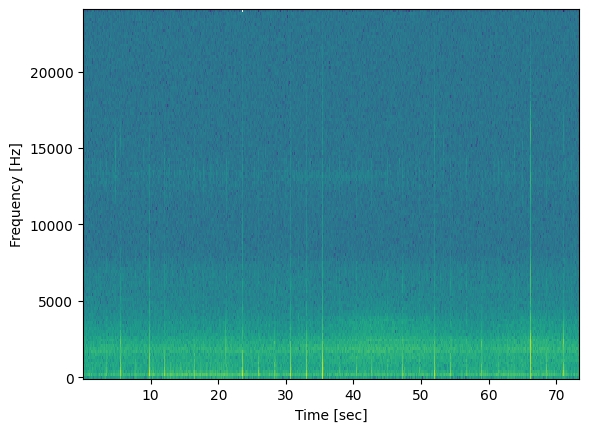

In [6]:
f, t, Sxx = signal.spectrogram(knuclke_raw, Fs)
plt.pcolormesh(t, f, 10*np.log10(Sxx))
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.show()

/tmp/ipykernel_104191/4056294177.py:2: RuntimeWarning: divide by zero encountered in log10
  plt.pcolormesh(t, f, 10*np.log10(Sxx))


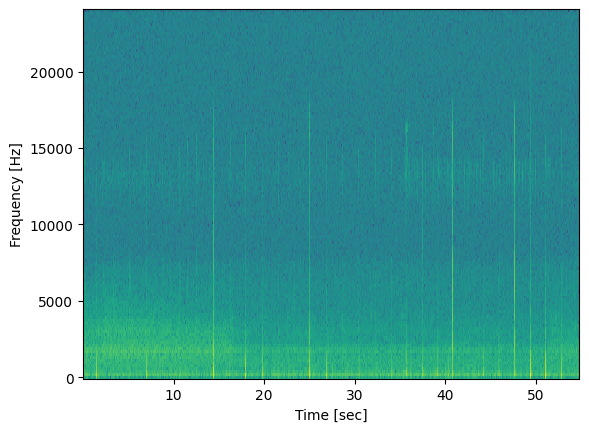

In [7]:
f, t, Sxx = signal.spectrogram(pad_raw, Fs)
plt.pcolormesh(t, f, 10*np.log10(Sxx))
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.show()

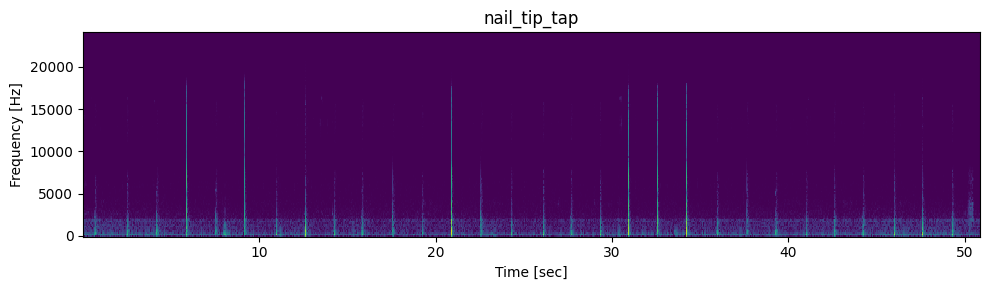

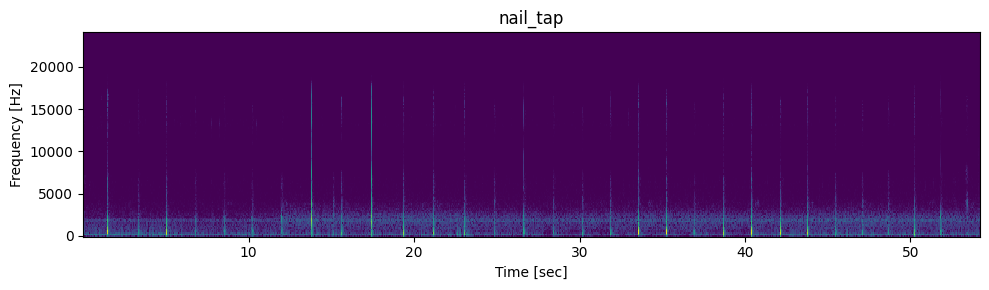

In [8]:

# Spectrograms (nail tip tap vs nail tap)
for name, x in [("nail_tip_tap", nail_tip_tap_raw), ("nail_tap", nail_tap_raw)]:
    f, t, Sxx = signal.spectrogram(x, Fs)
    plt.figure(figsize=(10, 3))
    plt.pcolormesh(t, f, 10*np.log10(Sxx + 1e-12), shading='auto')
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.title(name)
    plt.tight_layout()
    plt.show()


In [9]:
# Develop a auto segmentation method
# Step 1: get manually segmented data samples
# Step 2: feature engineering
# Step 3: build the program for auto segmentation
# Step 4: test the performance

In [10]:

# Step 1: get manually segmented data samples
knuckle_samples = []
for i in range(len(knckle_label)):
    start_index = int(knckle_label[i,0] * Fs)
    end_index = int(knckle_label[i,1] * Fs)
    knuckle_samples.append(knuclke_raw[start_index:end_index])

pad_samples = []
for i in range(len(pad_label)):
    start_index = int(pad_label[i,0] * Fs)
    end_index = int(pad_label[i,1] * Fs)
    pad_samples.append(pad_raw[start_index:end_index])

nail_tip_tap_samples = []
for i in range(len(nail_tip_tap_label)):
    start_index = int(nail_tip_tap_label[i,0] * Fs)
    end_index = int(nail_tip_tap_label[i,1] * Fs)
    nail_tip_tap_samples.append(nail_tip_tap_raw[start_index:end_index])

nail_tap_samples = []
for i in range(len(nail_tap_label)):
    start_index = int(nail_tap_label[i,0] * Fs)
    end_index = int(nail_tap_label[i,1] * Fs)
    nail_tap_samples.append(nail_tap_raw[start_index:end_index])


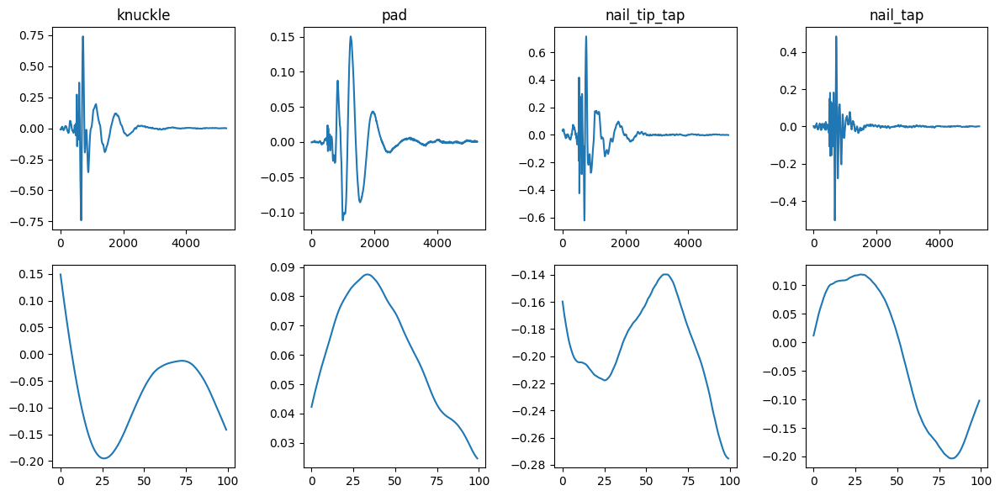

In [11]:

# Step 2: feature engineering (visualize 4 gesture samples)
plt.figure(figsize=(12, 6))

plt.subplot(2,4,1)
plt.plot(knuckle_samples[0])
plt.title('knuckle')
plt.subplot(2,4,5)
plt.plot(knuckle_samples[0][750:850])

plt.subplot(2,4,2)
plt.plot(pad_samples[0])
plt.title('pad')
plt.subplot(2,4,6)
plt.plot(pad_samples[0][800:900])

plt.subplot(2,4,3)
plt.plot(nail_tip_tap_samples[0])
plt.title('nail_tip_tap')
plt.subplot(2,4,7)
plt.plot(nail_tip_tap_samples[0][800:900])

plt.subplot(2,4,4)
plt.plot(nail_tap_samples[0])
plt.title('nail_tap')
plt.subplot(2,4,8)
plt.plot(nail_tap_samples[0][800:900])

plt.tight_layout()
plt.show()


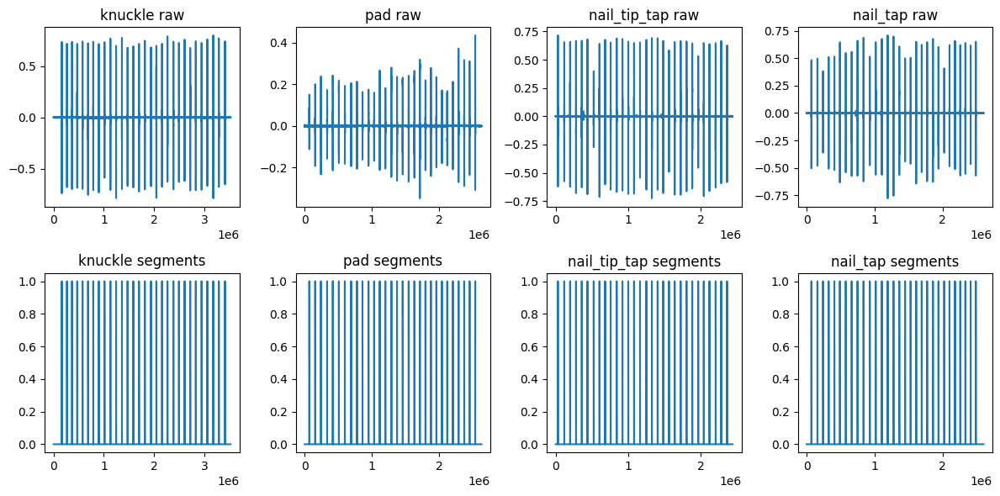

In [12]:

# Step 3: build the program for auto segmentation
plt.figure(figsize=(12, 6))

plt.subplot(2,4,1)
plt.plot(knuclke_raw)
plt.title('knuckle raw')

plt.subplot(2,4,2)
plt.plot(pad_raw)
plt.title('pad raw')

plt.subplot(2,4,3)
plt.plot(nail_tip_tap_raw)
plt.title('nail_tip_tap raw')

plt.subplot(2,4,4)
plt.plot(nail_tap_raw)
plt.title('nail_tap raw')


def identify_edge_index(data, thresh):
    data_size = len(data)
    temp = np.zeros(data_size)
    res = np.zeros(data_size)
    res_index = []
    start = 10
    for i in range(start, data_size):
        if data[i] - data[i-start] > thresh:
            temp[i] = 1
        else:
            temp[i] = 0

        if i > 350 and temp[i] == 1 and sum(temp[i-350: i]) == 0:
            res[i] = 1
            res_index.append(i)
        else:
            res[i] = 0

    return res, res_index


seg_knuckle, seg_index_knuckle = identify_edge_index(knuclke_raw, 0.2)
plt.subplot(2,4,5)
plt.plot(seg_knuckle)
plt.title('knuckle segments')

seg_pad, seg_index_pad = identify_edge_index(pad_raw, 0.012)
plt.subplot(2,4,6)
plt.plot(seg_pad)
plt.title('pad segments')

# NOTE: thresholds for nail_tip_tap vs nail_tap may differ; start with same default.
seg_nail_tip_tap, seg_index_nail_tip_tap = identify_edge_index(nail_tip_tap_raw, 0.12)
plt.subplot(2,4,7)
plt.plot(seg_nail_tip_tap)
plt.title('nail_tip_tap segments')

seg_nail_tap, seg_index_nail_tap = identify_edge_index(nail_tap_raw, 0.12)
plt.subplot(2,4,8)
plt.plot(seg_nail_tap)
plt.title('nail_tap segments')

plt.tight_layout()
plt.show()


In [13]:

# Step 2: Sample length
# We would using a moving window for event detection
# get the average windows length
knuckle_sample_len = ((knckle_label[:,1] -  knckle_label[:,0]) * Fs).astype(int)
pad_sample_len = ((pad_label[:,1] -  pad_label[:,0]) * Fs).astype(int)
nail_tip_tap_sample_len = ((nail_tip_tap_label[:,1] -  nail_tip_tap_label[:,0]) * Fs).astype(int)
nail_tap_sample_len = ((nail_tap_label[:,1] -  nail_tap_label[:,0]) * Fs).astype(int)

print('knuckle mean len:', np.mean(knuckle_sample_len))
print('pad mean len:', np.mean(pad_sample_len))
print('nail_tip_tap mean len:', np.mean(nail_tip_tap_sample_len))
print('nail_tap mean len:', np.mean(nail_tap_sample_len))


knuckle mean len: 5279.1
pad mean len: 5279.166666666667
nail_tip_tap mean len: 5279.166666666667
nail_tap mean len: 5279.3


Sample - 0


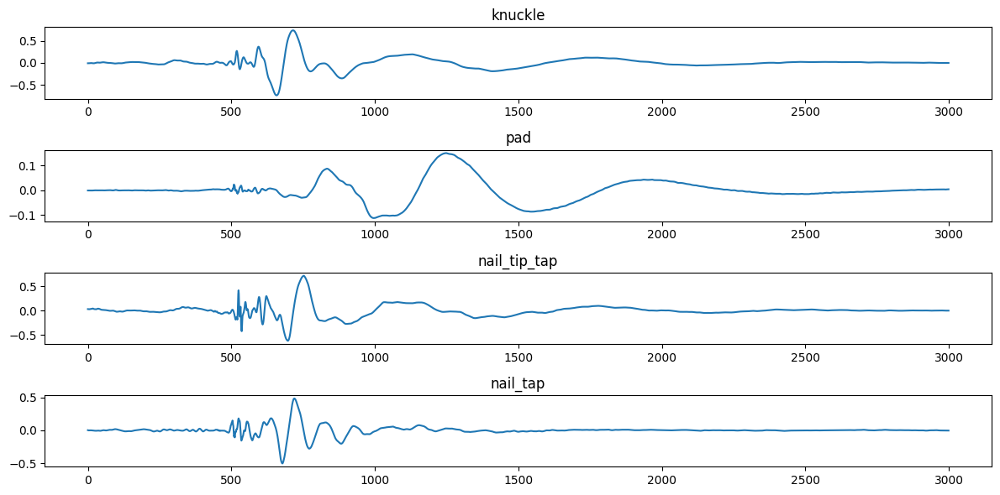

In [14]:
# Show some results (using labeled tap start times)
window_len = 3000

knuckle_sample = knuclke_raw[seg_index_knuckle_label[0]:(seg_index_knuckle_label[0] + window_len)]
pad_sample = pad_raw[seg_index_pad_label[0]:(seg_index_pad_label[0] + window_len)]
nail_tip_tap_sample = nail_tip_tap_raw[seg_index_nail_tip_tap_label[0]:(seg_index_nail_tip_tap_label[0] + window_len)]
nail_tap_sample = nail_tap_raw[seg_index_nail_tap_label[0]:(seg_index_nail_tap_label[0] + window_len)]

print("Sample - {0}".format(0))
plt.figure(figsize=(12, 6))

plt.subplot(4,1,1)
plt.plot(knuckle_sample)
plt.title('knuckle')

plt.subplot(4,1,2)
plt.plot(pad_sample)
plt.title('pad')

plt.subplot(4,1,3)
plt.plot(nail_tip_tap_sample)
plt.title('nail_tip_tap')

plt.subplot(4,1,4)
plt.plot(nail_tap_sample)
plt.title('nail_tap')

plt.tight_layout()
plt.show()


In [15]:
# Classification
# Step 1: feature engineering
# Step 2: build the classifier
# Step 3: evaluation

In [16]:
# FFT features of all samples
window_len = 3000

knuckle_sample_array = []
pad_sample_array = []
nail_tip_tap_sample_array = []
nail_tap_sample_array = []

def build_fft_features(raw, seg_indices, window_len, max_bins=9999):
    features = []
    for start in seg_indices:
        end = min(start + window_len, len(raw))
        sample = raw[start:end]
        if len(sample) < window_len:
            sample = np.pad(sample, (0, window_len - len(sample)), mode='constant')

        sp = np.fft.fft(sample, Fs)
        fft_mag = np.abs(sp) / len(sample)

        x = fft_mag[0:max_bins].astype(np.float32)
        x = x / (np.linalg.norm(x) + 1e-8)
        features.append(x.tolist())
    return features
print('Labeled segments - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}'.format(
    len(seg_index_knuckle_label), len(seg_index_pad_label), len(seg_index_nail_tip_tap_label), len(seg_index_nail_tap_label)
))

# Auto-detected indices (from the earlier segmentation cell) are kept for visualization only.
print('Auto-detected segments - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}'.format(
    len(seg_index_knuckle), len(seg_index_pad), len(seg_index_nail_tip_tap), len(seg_index_nail_tap)
))

knuckle_sample_array = build_fft_features(knuclke_raw, seg_index_knuckle_label, window_len)
pad_sample_array = build_fft_features(pad_raw, seg_index_pad_label, window_len)
nail_tip_tap_sample_array = build_fft_features(nail_tip_tap_raw, seg_index_nail_tip_tap_label, window_len)
nail_tap_sample_array = build_fft_features(nail_tap_raw, seg_index_nail_tap_label, window_len)

print('FFT feature counts - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}'.format(
    len(knuckle_sample_array), len(pad_sample_array), len(nail_tip_tap_sample_array), len(nail_tap_sample_array)
))


Labeled segments - knuckle: 30, pad: 30, nail_tip_tap: 30, nail_tap: 30
Auto-detected segments - knuckle: 30, pad: 37, nail_tip_tap: 30, nail_tap: 30
FFT feature counts - knuckle: 30, pad: 30, nail_tip_tap: 30, nail_tap: 30


In [17]:
# Build the classifier
# Method-1: the rule way
# This is your homework - 1

## Method 1: Rule-based classifier via spectral template matching

This baseline uses **template matching in the frequency domain**.

- **Training set**: recordings in `data/train/` with tap labels in `labels/*.txt`.
- **Test set**: separate recordings in `data/test/` with tap labels in `labels/*-test.txt`.

Each tap is represented by the magnitude of its FFT, and a single **template** (prototype spectrum) is computed per gesture from the training set. A new tap is classified as the gesture whose template is most similar to its spectrum.

### 1) Feature representation
For each segmented audio tap window `s`, we compute the FFT magnitude vector:

$$
x = |\mathrm{FFT}(s)| \in \mathbb{R}^d
$$

where $d$ is the number of frequency bins kept.

### 2) Build gesture templates (class prototypes)
For each gesture class $g \in \{\text{knuckle},\,\text{pad},\,\text{nail\_tip\_tap},\,\text{nail\_tap}\}$, we form a template by averaging all training spectra of that class:

$$
\mu_g = \frac{1}{N_g}\sum_{i=1}^{N_g} x_i^{(g)}
$$

### 3) Similarity measure (cosine similarity)
Given a sample spectrum $x$, we compute cosine similarity to each template:

$$
\cos(x,\mu_g) = \frac{x^\top \mu_g}{\|x\|\,\|\mu_g\| + \varepsilon}
$$

with a small $\varepsilon$ (e.g., $10^{-8}$) to avoid division by zero.

### 4) Decision rule
We assign the label of the template with the highest similarity:

$$
\hat{y} = \arg\max_{g}\; \cos(x,\mu_g)
$$

This method is fully deterministic: there are no learned parameters beyond the per-class mean spectra.


In [18]:

# ---------- Method-1: Rule-based classifier (template matching) ----------

import numpy as np
from sklearn.metrics import accuracy_score

# Build train feature matrix and labels from the FFT features
X_train = np.array(
    knuckle_sample_array + pad_sample_array + nail_tip_tap_sample_array + nail_tap_sample_array
)
y_train = np.array(
    [0] * len(knuckle_sample_array)
    + [1] * len(pad_sample_array)
    + [2] * len(nail_tip_tap_sample_array)
    + [3] * len(nail_tap_sample_array)
)

label_names = {0: "knuckle", 1: "pad", 2: "nail_tip_tap", 3: "nail_tap"}

# Class "templates" = average spectrum per gesture
knuckle_template      = np.mean(np.vstack(knuckle_sample_array), axis=0)
pad_template          = np.mean(np.vstack(pad_sample_array), axis=0)
nail_tip_tap_template = np.mean(np.vstack(nail_tip_tap_sample_array), axis=0)
nail_tap_template     = np.mean(np.vstack(nail_tap_sample_array), axis=0)

def cosine_sim(a, b, eps=1e-8):
    a = np.asarray(a)
    b = np.asarray(b)
    return float(np.dot(a, b) / ((np.linalg.norm(a) * np.linalg.norm(b)) + eps))

def rule_based_predict_one(x_fft):
    sims = [
        cosine_sim(x_fft, knuckle_template),
        cosine_sim(x_fft, pad_template),
        cosine_sim(x_fft, nail_tip_tap_template),
        cosine_sim(x_fft, nail_tap_template),
    ]
    return int(np.argmax(sims))   # 0 / 1 / 2 / 3

def rule_based_predict(X):
    return np.array([rule_based_predict_one(x) for x in X])

# Sanity check on the training set
rb_train_pred = rule_based_predict(X_train)
print("Rule-based TRAIN accuracy:", accuracy_score(y_train, rb_train_pred))


Rule-based TRAIN accuracy: 0.9833333333333333


In [19]:
# # Method-2: the ML way
# # This is your homework - 1
# from sklearn import svm
# X = knuckle_sample_array[0:-1]
# X.extend(pad_sample_array[0:-1])
# X.extend(nail_tip_tap_sample_array[0:-1])
# X.extend(nail_tap_sample_array[0:-1])

# y = [0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,1,1,1,2,2,2,2,2,2,2,2,2]
# clf = svm.SVC()
# clf.fit(X, y)


## Method-2: the ML way (k-NN + Random Forest)

This section adds two lightweight ML baselines on the same FFT feature vectors.

- **Input features**: the FFT magnitude vectors (same as Method‑1).
- **Classifiers**: `KNeighborsClassifier(n_neighbors=3)` and `RandomForestClassifier(...)` from scikit‑learn.
- **Evaluation**: we fit on the full training set and evaluate on the fixed external test set (`X_test`, `y_test`) built from the separate test recordings and their label files.


In [20]:
# Method-2: the ML way (k-NN + Random Forest)

from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

# Reuse X_train, y_train defined in Method-1
# We now have a separate external test recording per gesture, so we fit on the full training set.

knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_train, y_train)
print("kNN TRAIN accuracy:", accuracy_score(y_train, knn.predict(X_train)))

rf = RandomForestClassifier(
    n_estimators=200,
    random_state=42,
    n_jobs=1,
)
rf.fit(X_train, y_train)
print("RF TRAIN accuracy:", accuracy_score(y_train, rf.predict(X_train)))


kNN TRAIN accuracy: 0.9916666666666667
RF TRAIN accuracy: 1.0


TEST taps (from labels) - knuckle: 15, pad: 15, nail_tip_tap: 15, nail_tap: 15


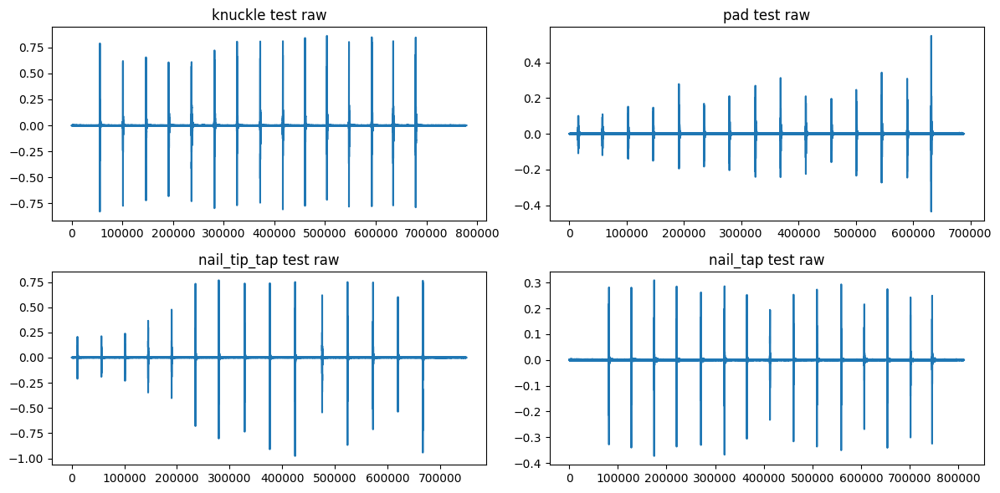

In [21]:
# Step 4: evaluate on separate TEST audio files (external test set)
# These recordings should contain only one gesture class each.

from pathlib import Path

knuckle_test_file = "./data/test/Knuckle-test.m4a"
# NOTE: this recording corresponds to the "pad" class.
pad_test_file = "./data/test/Pad-test.m4a"
nail_tip_tap_test_file = "./data/test/Nail tip tap-test.m4a"
nail_tap_test_file = "./data/test/Nail tap-test.m4a"

knuckle_test_label_file = "./labels/Knuckle-test.txt"
# NOTE: this label track corresponds to the "pad" class.
pad_test_label_file = "./labels/Pad-test.txt"
nail_tip_tap_test_label_file = "./labels/Nail tip tap-test.txt"
nail_tap_test_label_file = "./labels/Nail tap-test.txt"

test_files = {
    "knuckle": (knuckle_test_file, knuckle_test_label_file),
    "pad": (pad_test_file, pad_test_label_file),
    "nail_tip_tap": (nail_tip_tap_test_file, nail_tip_tap_test_label_file),
    "nail_tap": (nail_tap_test_file, nail_tap_test_label_file),
}

missing = [
    name
    for name, (audio_p, label_p) in test_files.items()
    if (not Path(audio_p).exists()) or (not Path(label_p).exists())
]
RUN_TEST_EVAL = (len(missing) == 0)

if not RUN_TEST_EVAL:
    print("Skipping TEST evaluation; missing audio/label files:", missing)
else:
    knuckle_test_raw, Fs_knuckle_test = load_audio(knuckle_test_file)
    pad_test_raw, Fs_pad_test = load_audio(pad_test_file)
    nail_tip_tap_test_raw, Fs_nail_tip_tap_test = load_audio(nail_tip_tap_test_file)
    nail_tap_test_raw, Fs_nail_tap_test = load_audio(nail_tap_test_file)

    if not (Fs_knuckle_test == Fs_pad_test == Fs_nail_tip_tap_test == Fs_nail_tap_test == Fs):
        raise ValueError(
            "Sample rates differ (must also match training Fs): "
            f"train={Fs}, knuckle_test={Fs_knuckle_test}, pad_test={Fs_pad_test}, "
            f"nail_tip_tap_test={Fs_nail_tip_tap_test}, nail_tap_test={Fs_nail_tap_test}"
        )

    knuckle_test_label = np.loadtxt(knuckle_test_label_file, delimiter="	", skiprows=0)
    pad_test_label = np.loadtxt(pad_test_label_file, delimiter="	", skiprows=0)
    nail_tip_tap_test_label = np.loadtxt(nail_tip_tap_test_label_file, delimiter="	", skiprows=0)
    nail_tap_test_label = np.loadtxt(nail_tap_test_label_file, delimiter="	", skiprows=0)

    knuckle_test_label = np.atleast_2d(knuckle_test_label)
    pad_test_label = np.atleast_2d(pad_test_label)
    nail_tip_tap_test_label = np.atleast_2d(nail_tip_tap_test_label)
    nail_tap_test_label = np.atleast_2d(nail_tap_test_label)

    # Convert Audacity label times (sec) -> start indices (samples)
    seg_index_knuckle_test = [int(t * Fs) for t in knuckle_test_label[:, 0]]
    seg_index_pad_test = [int(t * Fs) for t in pad_test_label[:, 0]]
    seg_index_nail_tip_tap_test = [int(t * Fs) for t in nail_tip_tap_test_label[:, 0]]
    seg_index_nail_tap_test = [int(t * Fs) for t in nail_tap_test_label[:, 0]]

    print(
        "TEST taps (from labels) - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}".format(
            len(seg_index_knuckle_test),
            len(seg_index_pad_test),
            len(seg_index_nail_tip_tap_test),
            len(seg_index_nail_tap_test),
        )
    )

    plt.figure(figsize=(12, 6))
    plt.subplot(2, 2, 1)
    plt.plot(knuckle_test_raw)
    plt.title("knuckle test raw")

    plt.subplot(2, 2, 2)
    plt.plot(pad_test_raw)
    plt.title("pad test raw")

    plt.subplot(2, 2, 3)
    plt.plot(nail_tip_tap_test_raw)
    plt.title("nail_tip_tap test raw")

    plt.subplot(2, 2, 4)
    plt.plot(nail_tap_test_raw)
    plt.title("nail_tap test raw")

    plt.tight_layout()
    plt.show()


In [22]:
# FFT features of TEST samples
window_len = 3000

if not RUN_TEST_EVAL:
    print('Skipping TEST FFT feature extraction (missing test files).')
else:
    knuckle_sample_array_test = build_fft_features(knuckle_test_raw, seg_index_knuckle_test, window_len)
    pad_sample_array_test = build_fft_features(pad_test_raw, seg_index_pad_test, window_len)
    nail_tip_tap_sample_array_test = build_fft_features(nail_tip_tap_test_raw, seg_index_nail_tip_tap_test, window_len)
    nail_tap_sample_array_test = build_fft_features(nail_tap_test_raw, seg_index_nail_tap_test, window_len)

    print('TEST FFT feature counts - knuckle: {}, pad: {}, nail_tip_tap: {}, nail_tap: {}'.format(
        len(knuckle_sample_array_test), len(pad_sample_array_test), len(nail_tip_tap_sample_array_test), len(nail_tap_sample_array_test)
    ))


TEST FFT feature counts - knuckle: 15, pad: 15, nail_tip_tap: 15, nail_tap: 15


In [23]:

# (Optional) If you had a trained sklearn model 'clf', you could run:
# clf.predict(nail_tip_tap_sample_array_test)
# clf.predict(nail_tap_sample_array_test)


In [24]:

# ---------- Evaluate both methods on the TEST audio ----------

from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

if not RUN_TEST_EVAL:
    print('Skipping TEST evaluation (missing test files).')
else:
    X_test = np.array(
        knuckle_sample_array_test
        + pad_sample_array_test
        + nail_tip_tap_sample_array_test
        + nail_tap_sample_array_test
    )
    y_test = np.array(
        [0] * len(knuckle_sample_array_test)
        + [1] * len(pad_sample_array_test)
        + [2] * len(nail_tip_tap_sample_array_test)
        + [3] * len(nail_tap_sample_array_test)
    )

    print('Test X shape:', X_test.shape)
    print('Test y shape:', y_test.shape)

    # Rule-based method
    rb_test_pred = rule_based_predict(X_test)
    print('Rule-based TEST accuracy:', accuracy_score(y_test, rb_test_pred))
    print('Rule-based confusion matrix:', confusion_matrix(y_test, rb_test_pred))
    print('Rule-based classification report:',
          classification_report(y_test, rb_test_pred, target_names=[label_names[i] for i in range(4)], zero_division=0))

    # k-NN method
    knn_test_pred = knn.predict(X_test)
    print('kNN TEST accuracy:', accuracy_score(y_test, knn_test_pred))
    print('kNN confusion matrix:', confusion_matrix(y_test, knn_test_pred))
    print('kNN classification report:',
          classification_report(y_test, knn_test_pred, target_names=[label_names[i] for i in range(4)], zero_division=0))

    # Random Forest method
    rf_test_pred = rf.predict(X_test)
    print('RF TEST accuracy:', accuracy_score(y_test, rf_test_pred))
    print('RF confusion matrix:', confusion_matrix(y_test, rf_test_pred))
    print('RF classification report:',
          classification_report(y_test, rf_test_pred, target_names=[label_names[i] for i in range(4)], zero_division=0))


Test X shape: (60, 9999)
Test y shape: (60,)
Rule-based TEST accuracy: 0.6666666666666666
Rule-based confusion matrix: [[12  0  0  3]
 [ 2 13  0  0]
 [ 0  0  0 15]
 [ 0  0  0 15]]
Rule-based classification report:               precision    recall  f1-score   support

     knuckle       0.86      0.80      0.83        15
         pad       1.00      0.87      0.93        15
nail_tip_tap       0.00      0.00      0.00        15
    nail_tap       0.45      1.00      0.62        15

    accuracy                           0.67        60
   macro avg       0.58      0.67      0.60        60
weighted avg       0.58      0.67      0.60        60

kNN TEST accuracy: 0.6833333333333333
kNN confusion matrix: [[12  0  0  3]
 [ 1 14  0  0]
 [ 0  0  0 15]
 [ 0  0  0 15]]
kNN classification report:               precision    recall  f1-score   support

     knuckle       0.92      0.80      0.86        15
         pad       1.00      0.93      0.97        15
nail_tip_tap       0.00      0.00      0

# Dataset Size Exploration

This section explores how the size of the training dataset affects the performance of the rule-based template matcher, k-NN, and random forest.

Because we now include separate test recordings (with labels) for each gesture, the sweep:

- trains on increasing fractions of the **training** set, and
- always evaluates on the fixed **external test** set (`X_test`, `y_test`).


In [25]:
# Setup for dataset size exploration

print("="*60)
print("EXPLORING EFFECT OF DATASET SIZE ON PERFORMANCE")
print("="*60)


EXPLORING EFFECT OF DATASET SIZE ON PERFORMANCE


In [26]:
# Build complete feature matrix from training data
X_full = np.array(knuckle_sample_array + pad_sample_array + nail_tip_tap_sample_array + nail_tap_sample_array)
y_full = np.array(
    [0] * len(knuckle_sample_array) +
    [1] * len(pad_sample_array) +
    [2] * len(nail_tip_tap_sample_array) +
    [3] * len(nail_tap_sample_array)
)

print(f"Total training samples: {len(X_full)}")
print(f"Feature dimensions: {X_full.shape[1]}")

if ("X_test" not in globals()) or ("y_test" not in globals()):
    raise RuntimeError("External test set not found. Run the TEST cells above to create X_test/y_test.")

print(f"Total test samples: {len(X_test)}")


Total training samples: 120
Feature dimensions: 9999
Total test samples: 60


In [27]:
# Dataset size exploration (train on subsets of TRAIN, evaluate on external TEST)

from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier

RANDOM_STATE = 42

# External test set exists; use the full extracted training set for training.
X_train_full, y_train_full = X_full, y_full

print('Train size:', len(y_train_full), ' Test size:', len(y_test))
print('Train class counts:', {label_names[i]: int(np.sum(y_train_full == i)) for i in range(4)})
print('Test  class counts:', {label_names[i]: int(np.sum(y_test == i)) for i in range(4)})


dataset_sizes = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

# Store results
rule_based_train_acc = []
rule_based_test_acc = []
knn_train_acc = []
knn_test_acc = []
rf_train_acc = []
rf_test_acc = []
actual_sample_counts = []

# Store confusion matrices and classification reports for later inspection
rb_test_conf_mats = []
knn_test_conf_mats = []
rf_test_conf_mats = []
rb_test_reports = []
knn_test_reports = []
rf_test_reports = []

# Helper function for cosine similarity
def cosine_sim(a, b, eps=1e-8):
    a = np.asarray(a)
    b = np.asarray(b)
    return float(np.dot(a, b) / ((np.linalg.norm(a) * np.linalg.norm(b)) + eps))

for size in dataset_sizes:
    print()
    print(f"--- Training with {int(size*100)}% of TRAINING data ---")

    # Sample ONLY from the training set (X_train_full/y_train_full). The test set is fixed.
    if size < 1.0:
        sss = StratifiedShuffleSplit(n_splits=1, train_size=size, random_state=RANDOM_STATE)
        subset_idx, _ = next(sss.split(X_train_full, y_train_full))
        X_subset = X_train_full[subset_idx]
        y_subset = y_train_full[subset_idx]
    else:
        X_subset = X_train_full
        y_subset = y_train_full

    actual_sample_counts.append(len(X_subset))
    print(f"Training samples used: {len(X_subset)}")

    # ===== Rule-based Classifier (Template Matching) =====
    templates = [np.mean(X_subset[np.where(y_subset == cls)[0]], axis=0) for cls in range(4)]

    def rule_based_predict_sweep(X):
        preds = []
        for x in X:
            sims = [cosine_sim(x, t) for t in templates]
            preds.append(int(np.argmax(sims)))
        return np.array(preds)

    rb_train_pred = rule_based_predict_sweep(X_subset)
    rb_test_pred = rule_based_predict_sweep(X_test)

    rb_train_accuracy = accuracy_score(y_subset, rb_train_pred)
    rb_test_accuracy = accuracy_score(y_test, rb_test_pred)

    rule_based_train_acc.append(rb_train_accuracy)
    rule_based_test_acc.append(rb_test_accuracy)

    rb_test_conf_mats.append(confusion_matrix(y_test, rb_test_pred, labels=list(range(4))))
    rb_test_reports.append(
        classification_report(
            y_test,
            rb_test_pred,
            labels=list(range(4)),
            target_names=[label_names[i] for i in range(4)],
            zero_division=0,
        )
    )

    print(f"Rule-based - Train: {rb_train_accuracy:.3f}, Test: {rb_test_accuracy:.3f}")

    # ===== k-NN Classifier =====
    knn_sweep = KNeighborsClassifier(n_neighbors=3)
    knn_sweep.fit(X_subset, y_subset)

    knn_train_pred = knn_sweep.predict(X_subset)
    knn_test_pred = knn_sweep.predict(X_test)

    knn_train_accuracy = accuracy_score(y_subset, knn_train_pred)
    knn_test_accuracy = accuracy_score(y_test, knn_test_pred)

    knn_train_acc.append(knn_train_accuracy)
    knn_test_acc.append(knn_test_accuracy)

    knn_test_conf_mats.append(confusion_matrix(y_test, knn_test_pred, labels=list(range(4))))
    knn_test_reports.append(
        classification_report(
            y_test,
            knn_test_pred,
            labels=list(range(4)),
            target_names=[label_names[i] for i in range(4)],
            zero_division=0,
        )
    )

    print(f"k-NN - Train: {knn_train_accuracy:.3f}, Test: {knn_test_accuracy:.3f}")

    # ===== Random Forest Classifier =====
    rf_sweep = RandomForestClassifier(
        n_estimators=200,
        random_state=RANDOM_STATE,
        n_jobs=1,
    )
    rf_sweep.fit(X_subset, y_subset)

    rf_train_pred = rf_sweep.predict(X_subset)
    rf_test_pred = rf_sweep.predict(X_test)

    rf_train_accuracy = accuracy_score(y_subset, rf_train_pred)
    rf_test_accuracy = accuracy_score(y_test, rf_test_pred)

    rf_train_acc.append(rf_train_accuracy)
    rf_test_acc.append(rf_test_accuracy)

    rf_test_conf_mats.append(confusion_matrix(y_test, rf_test_pred, labels=list(range(4))))
    rf_test_reports.append(
        classification_report(
            y_test,
            rf_test_pred,
            labels=list(range(4)),
            target_names=[label_names[i] for i in range(4)],
            zero_division=0,
        )
    )

    print(f"RF - Train: {rf_train_accuracy:.3f}, Test: {rf_test_accuracy:.3f}")


Train size: 120  Test size: 60
Train class counts: {'knuckle': 30, 'pad': 30, 'nail_tip_tap': 30, 'nail_tap': 30}
Test  class counts: {'knuckle': 15, 'pad': 15, 'nail_tip_tap': 15, 'nail_tap': 15}

--- Training with 10% of TRAINING data ---
Training samples used: 12
Rule-based - Train: 1.000, Test: 0.650
k-NN - Train: 1.000, Test: 0.583
RF - Train: 1.000, Test: 0.533

--- Training with 20% of TRAINING data ---
Training samples used: 24
Rule-based - Train: 0.958, Test: 0.667
k-NN - Train: 0.958, Test: 0.633
RF - Train: 1.000, Test: 0.500

--- Training with 30% of TRAINING data ---
Training samples used: 36
Rule-based - Train: 0.972, Test: 0.667
k-NN - Train: 0.972, Test: 0.650
RF - Train: 1.000, Test: 0.517

--- Training with 40% of TRAINING data ---
Training samples used: 48
Rule-based - Train: 0.979, Test: 0.667
k-NN - Train: 0.979, Test: 0.683
RF - Train: 1.000, Test: 0.500

--- Training with 50% of TRAINING data ---
Training samples used: 60
Rule-based - Train: 0.983, Test: 0.667
k-

## Visualize Results

The plots below show **test accuracy vs. training dataset size** for:

- the rule-based template matcher
- the k-NN classifier
- the random forest classifier

Accuracy is reported on the fixed external test set.


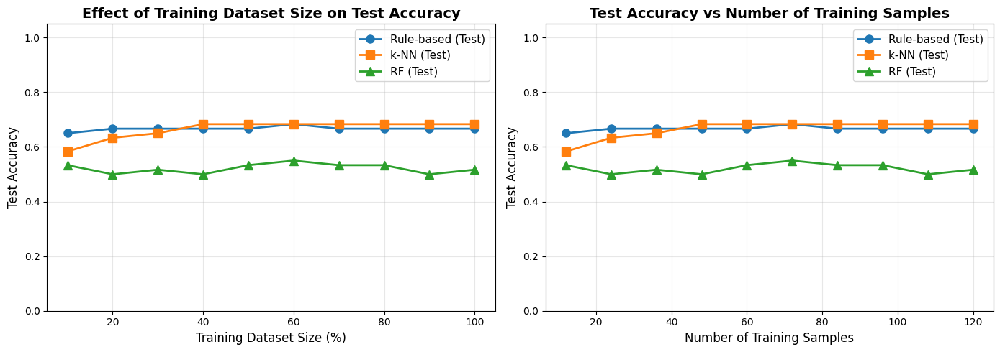


Visualization complete!


In [28]:
# Create visualization
plt.figure(figsize=(14, 5))

# Plot 1: Accuracy vs Dataset Size Percentage
plt.subplot(1, 2, 1)
plt.plot([s*100 for s in dataset_sizes], rule_based_test_acc, 'o-', 
         label='Rule-based (Test)', linewidth=2, markersize=8)
plt.plot([s*100 for s in dataset_sizes], knn_test_acc, 's-', 
         label='k-NN (Test)', linewidth=2, markersize=8)
plt.plot([s*100 for s in dataset_sizes], rf_test_acc, '^-', 
         label='RF (Test)', linewidth=2, markersize=8)
plt.xlabel('Training Dataset Size (%)', fontsize=12)
plt.ylabel('Test Accuracy', fontsize=12)
plt.title('Effect of Training Dataset Size on Test Accuracy', fontsize=14, fontweight='bold')
plt.legend(fontsize=11)
plt.grid(True, alpha=0.3)
plt.ylim([0, 1.05])

# Plot 2: Accuracy vs Actual Sample Count
plt.subplot(1, 2, 2)
plt.plot(actual_sample_counts, rule_based_test_acc, 'o-', 
         label='Rule-based (Test)', linewidth=2, markersize=8)
plt.plot(actual_sample_counts, knn_test_acc, 's-', 
         label='k-NN (Test)', linewidth=2, markersize=8)
plt.plot(actual_sample_counts, rf_test_acc, '^-', 
         label='RF (Test)', linewidth=2, markersize=8)
plt.xlabel('Number of Training Samples', fontsize=12)
plt.ylabel('Test Accuracy', fontsize=12)
plt.title('Test Accuracy vs Number of Training Samples', fontsize=14, fontweight='bold')
plt.legend(fontsize=11)
plt.grid(True, alpha=0.3)
plt.ylim([0, 1.05])

plt.tight_layout()
plt.show()

print("\nVisualization complete!")

## Summary Results

The table summarizes test accuracy for each training dataset size.

For the best run of each method (rule-based, k-NN, random forest), the notebook also prints:

- the confusion matrix (rows=true class, columns=predicted), and
- the per-class precision/recall/F1 classification report,

all computed on the fixed external test set.


In [29]:

# Print summary statistics
print("="*60)
print("SUMMARY RESULTS")
print("="*60)

print("Dataset Size Effects on Test Accuracy:")
print("-" * 60)
print(f"{'Size (%)':>10} {'Samples':>10} {'Rule-based':>15} {'k-NN':>15} {'RF':>15}")
print("-" * 60)
for i, size in enumerate(dataset_sizes):
    print(f"{size*100:>10.0f} {actual_sample_counts[i]:>10} "
          f"{rule_based_test_acc[i]:>15.3f} {knn_test_acc[i]:>15.3f} {rf_test_acc[i]:>15.3f}")

best_rb_i = int(np.argmax(rule_based_test_acc))
best_knn_i = int(np.argmax(knn_test_acc))
best_rf_i = int(np.argmax(rf_test_acc))

print("" + "="*60)
print(f"Best Rule-based Accuracy: {rule_based_test_acc[best_rb_i]:.3f} at {dataset_sizes[best_rb_i]*100:.0f}% of data")
print(f"Best k-NN Accuracy: {knn_test_acc[best_knn_i]:.3f} at {dataset_sizes[best_knn_i]*100:.0f}% of data")
print(f"Best RF Accuracy: {rf_test_acc[best_rf_i]:.3f} at {dataset_sizes[best_rf_i]*100:.0f}% of data")
print("="*60)

print("Best Rule-based confusion matrix (rows=true, cols=pred; labels 0..3):")
print(rb_test_conf_mats[best_rb_i])
print("Best Rule-based classification report:")
print(rb_test_reports[best_rb_i])

print("Best k-NN confusion matrix (rows=true, cols=pred; labels 0..3):")
print(knn_test_conf_mats[best_knn_i])
print("Best k-NN classification report:")
print(knn_test_reports[best_knn_i])

print("Best RF confusion matrix (rows=true, cols=pred; labels 0..3):")
print(rf_test_conf_mats[best_rf_i])
print("Best RF classification report:")
print(rf_test_reports[best_rf_i])


SUMMARY RESULTS
Dataset Size Effects on Test Accuracy:
------------------------------------------------------------
  Size (%)    Samples      Rule-based            k-NN              RF
------------------------------------------------------------
        10         12           0.650           0.583           0.533
        20         24           0.667           0.633           0.500
        30         36           0.667           0.650           0.517
        40         48           0.667           0.683           0.500
        50         60           0.667           0.683           0.533
        60         72           0.683           0.683           0.550
        70         84           0.667           0.683           0.533
        80         96           0.667           0.683           0.533
        90        108           0.667           0.683           0.500
       100        120           0.667           0.683           0.517
Best Rule-based Accuracy: 0.683 at 60% of data
Best k

## Key Observations

1. **Train vs test mismatch is expected**: test accuracy can drop a lot when test recordings are collected in a separate session with different force, placement, or noise.

2. **Rule-based vs ML**: the template matcher can work with fewer samples; k-NN and random forests can fit the training data very well but may degrade under distribution shift.

3. **Use confusion matrices**: look at per-class recall to see which gestures are being confused (commonly `nail_tip_tap` vs `nail_tap`).

4. **If test performance is low**: improve onset alignment and consider normalizing features (e.g., log-magnitude, per-sample normalization) before classification.
